In [1]:
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from PIL import Image
import torchvision
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
import torch.optim as optim
import torch.nn.functional as F
import random


name the directories

In [2]:
train_dir ="/content/drive/MyDrive/plant_detection_dataset/train"
valid_dir ="/content/drive/MyDrive/plant_detection_dataset/valid"
test_dir ="/content/drive/MyDrive/plant_detection_dataset/test"
plant_classes = os.listdir(train_dir)

In [3]:
print(plant_classes)
print("\nTotal number of classes are: ", len(plant_classes))

['Rose', 'Tulsi', 'Guava', 'Mango', 'Lemon', 'Pepper', 'Neem', 'Papaya', 'Mint', 'Pipal', 'Eucalyptus', 'jasmine', 'Ashoka', 'Aloevera', 'Amruthaballi', 'Bamboo', 'Ashwagandha', 'Amla']

Total number of classes are:  18


The Number of Images in Rose: 138
The Number of Images in Tulsi: 162
The Number of Images in Guava: 82
The Number of Images in Mango: 126
The Number of Images in Lemon: 148
The Number of Images in Pepper: 78
The Number of Images in Neem: 140
The Number of Images in Papaya: 142
The Number of Images in Mint: 145
The Number of Images in Pipal: 95
The Number of Images in Eucalyptus: 45
The Number of Images in jasmine: 119
The Number of Images in Ashoka: 115
The Number of Images in Aloevera: 122
The Number of Images in Amruthaballi: 129
The Number of Images in Bamboo: 92
The Number of Images in Ashwagandha: 74
The Number of Images in Amla: 88

Total Number of Images in Directory:  2040


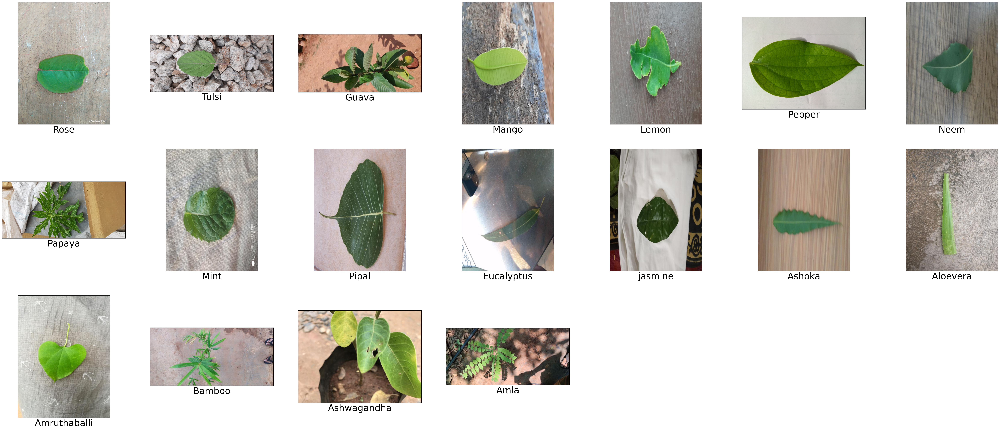

In [4]:
plt.figure(figsize=(60,60), dpi=200)
cnt = 0
plant_names = []
tot_images = 0
Len = []

for i in plant_classes:
    cnt += 1
    plant_names.append(i)
    plt.subplot(7,7,cnt)

    image_path = os.listdir(train_dir + "/" + i)
    Len.append(len(image_path))
    print("The Number of Images in " +i+ ":", len(image_path))
    tot_images += len(image_path)

    img_show = plt.imread(train_dir + "/" + i + "/" + image_path[0])

    plt.imshow(img_show)
    plt.xlabel(i,fontsize=30)
    plt.xticks([])
    plt.yticks([])


print("\nTotal Number of Images in Directory: ", tot_images)

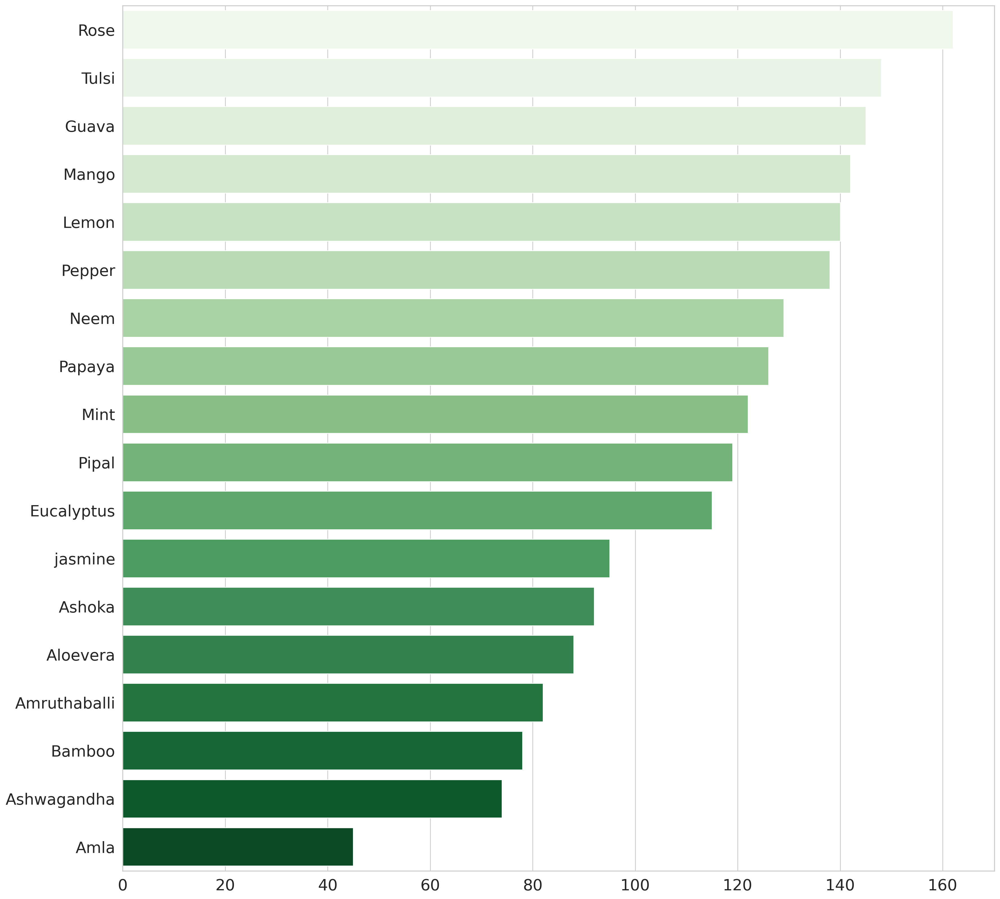

In [5]:
Len.sort(reverse=True)

sns.set(style="whitegrid", color_codes=True)
plt.figure(figsize=(20,20),dpi=200)
ax = sns.barplot(x= Len, y= plant_names, palette="Greens")
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.show()

In [6]:
train_transform = transforms.Compose([
    transforms.Resize((224, 224)), # Resize images to 224x224
    transforms.ToTensor()
])
train = ImageFolder(train_dir, transform=train_transform) # Applying transform to the train dataset
valid_transform = transforms.Compose([
    transforms.Resize((224, 224)), # Resize images to 224x224
    transforms.ToTensor()
])
valid = ImageFolder(valid_dir, transform=valid_transform)

In [7]:
train

Dataset ImageFolder
    Number of datapoints: 2040
    Root location: /content/drive/MyDrive/plant_detection_dataset/train
    StandardTransform
Transform: Compose(
               Resize(size=(224, 224), interpolation=bilinear, max_size=None, antialias=True)
               ToTensor()
           )

In [8]:
train[0]

(tensor([[[0.2118, 0.2078, 0.2000,  ..., 0.2314, 0.2157, 0.1882],
          [0.2000, 0.2000, 0.2000,  ..., 0.2235, 0.2039, 0.1686],
          [0.1961, 0.1961, 0.1961,  ..., 0.2157, 0.1961, 0.1765],
          ...,
          [0.2078, 0.2000, 0.1882,  ..., 0.1804, 0.1529, 0.1608],
          [0.1961, 0.1804, 0.1843,  ..., 0.1843, 0.1569, 0.1608],
          [0.2118, 0.2039, 0.2078,  ..., 0.1804, 0.1686, 0.1569]],
 
         [[0.1922, 0.1961, 0.1882,  ..., 0.2471, 0.2392, 0.2235],
          [0.1804, 0.1882, 0.1882,  ..., 0.2392, 0.2275, 0.2000],
          [0.1765, 0.1843, 0.1843,  ..., 0.2353, 0.2157, 0.2000],
          ...,
          [0.1765, 0.1686, 0.1608,  ..., 0.1373, 0.1059, 0.1137],
          [0.1647, 0.1490, 0.1569,  ..., 0.1373, 0.1098, 0.1098],
          [0.1804, 0.1725, 0.1804,  ..., 0.1333, 0.1216, 0.1059]],
 
         [[0.2196, 0.2235, 0.2157,  ..., 0.2510, 0.2392, 0.2196],
          [0.2078, 0.2157, 0.2157,  ..., 0.2431, 0.2275, 0.1961],
          [0.2039, 0.2118, 0.2118,  ...,

In [9]:
train[700]

(tensor([[[0.8941, 0.8863, 0.8784,  ..., 0.4902, 0.4235, 0.3647],
          [0.9059, 0.8980, 0.8863,  ..., 0.4941, 0.4353, 0.3882],
          [0.9098, 0.9020, 0.8941,  ..., 0.4549, 0.4549, 0.4471],
          ...,
          [0.8431, 0.8392, 0.8667,  ..., 0.4157, 0.3569, 0.3451],
          [0.8471, 0.8588, 0.8667,  ..., 0.3569, 0.3686, 0.3451],
          [0.8471, 0.8549, 0.8627,  ..., 0.3098, 0.3804, 0.3451]],
 
         [[0.7608, 0.7529, 0.7451,  ..., 0.4392, 0.3765, 0.3176],
          [0.7725, 0.7647, 0.7529,  ..., 0.4431, 0.3882, 0.3412],
          [0.7765, 0.7686, 0.7608,  ..., 0.4039, 0.4078, 0.4000],
          ...,
          [0.7020, 0.6980, 0.7255,  ..., 0.3608, 0.3020, 0.2902],
          [0.7059, 0.7176, 0.7255,  ..., 0.3020, 0.3137, 0.2902],
          [0.7098, 0.7176, 0.7216,  ..., 0.2549, 0.3255, 0.2902]],
 
         [[0.7137, 0.7059, 0.6980,  ..., 0.4471, 0.3843, 0.3255],
          [0.7255, 0.7176, 0.7059,  ..., 0.4510, 0.3961, 0.3490],
          [0.7294, 0.7216, 0.7137,  ...,

In [10]:
img, label = train[0]
print(img.shape, label)

torch.Size([3, 224, 224]) 0


Label :Aloevera(0)
Label :Amruthaballi(2)
Label :Aloevera(0)
Label :Aloevera(0)
Label :Neem(11)
Label :Pepper(13)
Label :Bamboo(5)
Label :Guava(7)


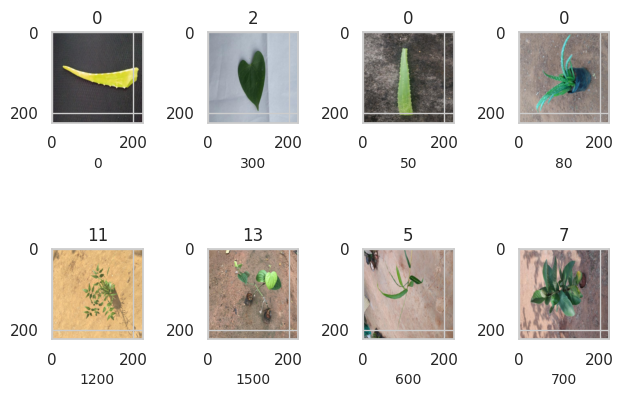

In [11]:
def show_image(image, label):
    print("Label :" + train.classes[label] + "(" + str(label) + ")")
    plt.imshow(image.permute(1, 2, 0))


image_list = [0, 300, 50, 80, 1200, 1500, 600, 700]

chs = 0
for img in image_list:
    chs += 1
    plt.subplot(2,4,chs)
    plt.tight_layout()
    plt.xlabel(img,fontsize=10)
    plt.title(train[img][1])
    show_image(*train[img])

In [12]:
batch_size = 32

In [13]:
# DataLoaders for training and validation
train_dataloader = DataLoader(train, batch_size, shuffle=True, num_workers=2, pin_memory=True)
valid_dataloader = DataLoader(valid, batch_size, num_workers=2, pin_memory=True)

In [14]:
# for moving data into GPU (if available)
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available: # This was the problem, if cuda is not available/configured the if statement fails
        return torch.device("cuda")
    else:
        return torch.device("cpu")
    return torch.device("cpu") # Forcing the device to be the CPU

In [15]:
# for moving data to device (CPU or GPU)
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

In [16]:
# for loading in the device (GPU if available else CPU)
class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dataloader, device):
        self.dataloader = dataloader
        self.device = device

    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dataloader:
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dataloader)

In [17]:
device = get_default_device()
device

device(type='cuda')

In [18]:
# Moving data into GPU, WrappedDataLoader
train_dataloader = DeviceDataLoader(train_dataloader, device)
valid_dataloader = DeviceDataLoader(valid_dataloader, device)

In [19]:
# for calculating the accuracy
def accuracy(outputs, labels):
    _, preds = torch.max(outputs, dim=1)
    return torch.tensor(torch.sum(preds == labels).item() / len(preds))

In [20]:
class ImageClassificationBase(nn.Module):

    def training_step(self, batch):
        images, labels = batch
        out = self(images)                  # Generate predictions
        loss = F.cross_entropy(out, labels) # Calculate loss
        return loss

    def validation_step(self, batch):
        images, labels = batch
        out = self(images)                    # Generate predictions
        loss = F.cross_entropy(out, labels)   # Calculate loss
        acc = accuracy(out, labels)           # Calculate accuracy
        return {'val_loss': loss.detach(), 'val_acc': acc}

    def validation_epoch_end(self, outputs):
        batch_losses = [x['val_loss'] for x in outputs]
        epoch_loss = torch.stack(batch_losses).mean()   # Combine losses
        batch_accs = [x['val_acc'] for x in outputs]
        epoch_acc = torch.stack(batch_accs).mean()      # Combine accuracies
        return {'val_loss': epoch_loss.item(), 'val_acc': epoch_acc.item()}

    def epoch_end(self, epoch, result):
        print("Epoch [{}], train_loss: {:.4f}, val_loss: {:.4f}, val_acc: {:.4f}".format(
            epoch, result['train_loss'], result['val_loss'], result['val_acc']))

In [21]:
# convolution block with BatchNormalization
def ConvBlock(in_channels, out_channels, pool=False):
    layers = [nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
             nn.BatchNorm2d(out_channels),
             nn.ReLU(inplace=True)]
    if pool:
        layers.append(nn.MaxPool2d(4))
    return nn.Sequential(*layers)

In [22]:
# resnet architecture
class CNN_NeuralNet(ImageClassificationBase):
    def __init__(self, in_channels, num_plant):
        super().__init__()

        self.conv1 = ConvBlock(in_channels, 64)
        self.conv2 = ConvBlock(64, 128, pool=True)
        self.res1 = nn.Sequential(ConvBlock(128, 128), ConvBlock(128, 128))

        self.conv3 = ConvBlock(128, 256, pool=True)
        self.conv4 = ConvBlock(256, 512, pool=True)
        #self.conv5 = ConvBlock(256, 256, pool=True)
        #self.conv6 = ConvBlock(256, 512, pool=True)
        #self.conv7 = ConvBlock(512, 512, pool=True)

        self.res2 = nn.Sequential(ConvBlock(512, 512), ConvBlock(512, 512))

        self.classifier = nn.Sequential(nn.MaxPool2d(2), # Changed kernel_size to 2
                                       nn.Flatten(),
                                       nn.Linear(512, num_plant)) # Adjust input features for linear layer

    def forward(self, x): # x is the loaded batch
        out = self.conv1(x)
        out = self.conv2(out)
        out = self.res1(out) + out
        out = self.conv3(out)
        out = self.conv4(out)
        #out = self.conv5(out)
        #out = self.conv6(out)
        #out = self.conv7(out)
        out = self.res2(out) + out
        out = self.res2(out) + out
        out = self.classifier(out)
        return out

In [23]:
# defining the model and moving it to the GPU
# 3 is number of channels RGB, len(train.classes()) is number of plant.
model = to_device(CNN_NeuralNet(3, len(train.classes)), device)
model

CNN_NeuralNet(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  )
  (res1): Sequential(
    (0): Sequential(
      (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inpl

In [24]:
# for training
@torch.no_grad()
def evaluate(model, val_loader):
    model.eval()
    outputs = [model.validation_step(batch) for batch in val_loader]
    return model.validation_epoch_end(outputs)

In [25]:
def get_lr(optimizer):
    for param_group in optimizer.param_groups:
        return param_group['lr']

In [26]:
def fit_OneCycle(epochs, max_lr, model, train_loader, val_loader, weight_decay=0,
                grad_clip=None, opt_func=torch.optim.SGD):
    torch.cuda.empty_cache()
    history = []  #For collecting the results

    optimizer = opt_func(model.parameters(), max_lr, weight_decay=weight_decay)
    # scheduler for one cycle learniing rate
    #Sets the learning rate of each parameter group according to the 1cycle learning rate policy.
    #The 1cycle policy anneals the learning rate from an initial learning rate to some
    #maximum learning rate and then from that maximum learning rate to some minimum learning rate
    #much lower than the initial learning rate.
    sched = torch.optim.lr_scheduler.OneCycleLR(optimizer, max_lr,
                                                epochs=epochs, steps_per_epoch=len(train_loader))
    for epoch in range(epochs):
        # Training
        model.train()
        train_losses = []
        lrs = []
        for batch in train_loader:
            loss = model.training_step(batch)
            train_losses.append(loss)
            loss.backward()

            # gradient clipping
            #Clip the gradients of an iterable of parameters at specified value.
            #All from pytorch documantation.
            if grad_clip:
                nn.utils.clip_grad_value_(model.parameters(), grad_clip)

            optimizer.step()
            optimizer.zero_grad()

            # recording and updating learning rates
            lrs.append(get_lr(optimizer))
            sched.step()
             # validation

        result = evaluate(model, val_loader)
        result['train_loss'] = torch.stack(train_losses).mean().item()
        result['lrs'] = lrs
        model.epoch_end(epoch, result)
        history.append(result)

    return history


In [27]:
#%%time
history = [evaluate(model, valid_dataloader)]
history

[{'val_loss': 2.8909032344818115, 'val_acc': 0.056985292583703995}]

In [28]:
num_epoch = 5
lr_rate = 0.01
grad_clip = 0.15
weight_decay = 1e-4
optims = torch.optim.Adam

In [29]:
#%%time
history += fit_OneCycle(num_epoch, lr_rate, model, train_dataloader, valid_dataloader,
                             grad_clip=grad_clip,
                             weight_decay=weight_decay,
                             opt_func=optims)

Epoch [0], train_loss: 3.0847, val_loss: 28.1468, val_acc: 0.0294
Epoch [1], train_loss: 2.6045, val_loss: 6.0591, val_acc: 0.1500
Epoch [2], train_loss: 1.7935, val_loss: 4.5265, val_acc: 0.1730
Epoch [3], train_loss: 1.0134, val_loss: 4.7136, val_acc: 0.2297
Epoch [4], train_loss: 0.6209, val_loss: 4.9855, val_acc: 0.2309


In [30]:
val_acc = []
val_loss = []
train_loss = []

for i in history:
    val_acc.append(i['val_acc'])
    val_loss.append(i['val_loss'])
    train_loss.append(i.get('train_loss'))

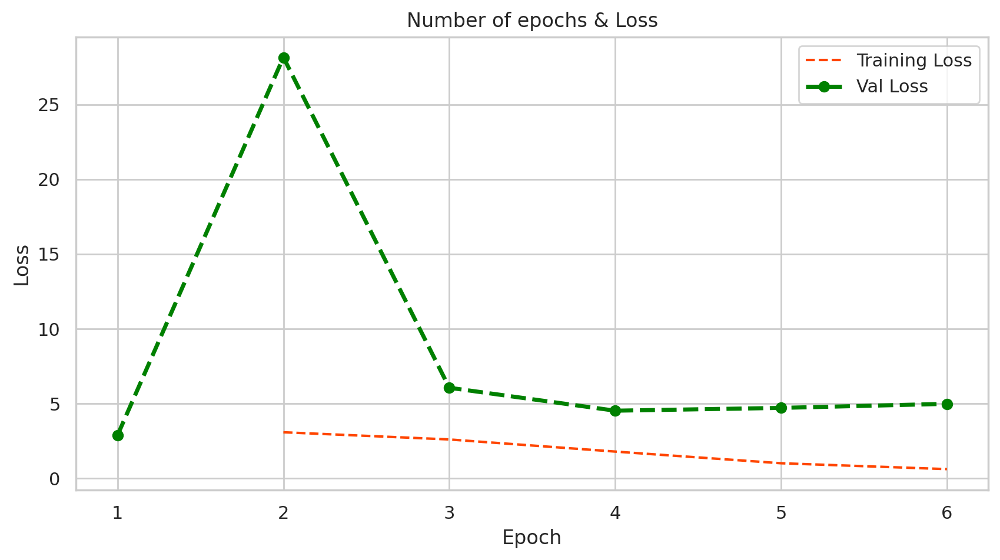

In [31]:
epoch_count = range(1,7)
plt.figure(figsize=(10,5), dpi=200)
plt.plot(epoch_count, train_loss, 'r--', color= 'orangered')
plt.plot(epoch_count, val_loss, '--bo',color= 'green', linewidth = '2.5', label='line with marker')
plt.legend(['Training Loss', 'Val Loss'])
plt.title('Number of epochs & Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.xticks(np.arange(1,7,1))
plt.show();

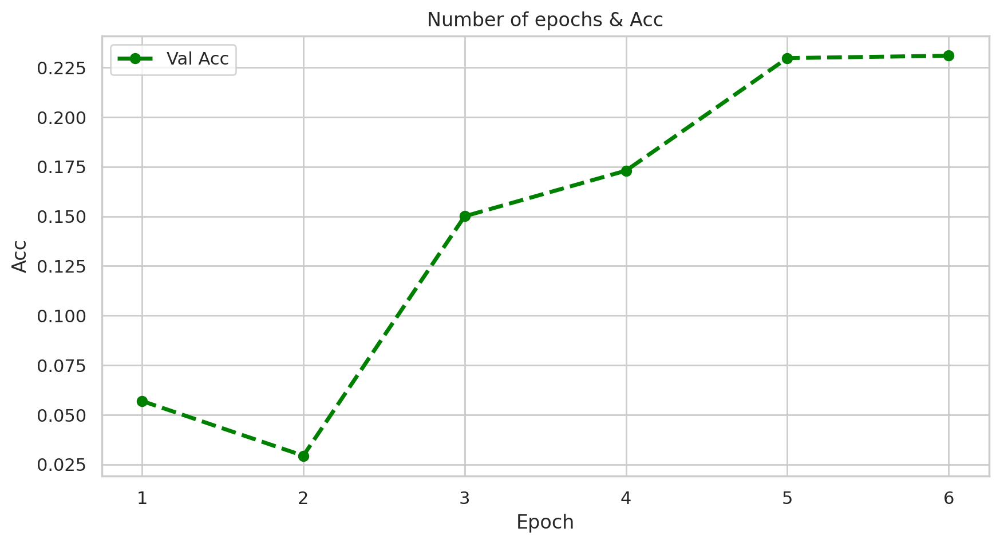

In [32]:
epoch_count = range(1,7)
plt.figure(figsize=(10,5), dpi=200)
plt.plot(epoch_count, val_acc, '--bo',color= 'green', linewidth = '2.5', label='line with marker')
plt.legend(['Val Acc'])
plt.title('Number of epochs & Acc')
plt.xlabel('Epoch')
plt.ylabel('Acc')
plt.xticks(np.arange(1,7,1))
plt.show();

In [39]:
test = ImageFolder(test_dir, transform=transforms.ToTensor())
test_images = sorted(os.listdir(test_dir)) # """+ '/test'"""
print(test_images)
print(len(test_images))

Dataset ImageFolder
    Number of datapoints: 905
    Root location: /content/drive/MyDrive/plant_detection_dataset/test
    StandardTransform
Transform: ToTensor()
905


In [44]:
def predict_image(img, model):
    """Converts image to array and return the predicted class
        with highest probability"""
    # Convert to a batch of 1
    xb = to_device(img.unsqueeze(0), device)
    # Get predictions from model
    yb = model(xb)
    # Pick index with highest probability
    _, preds  = torch.max(yb, dim=1)
    # Retrieve the class label

    return train.classes[preds[0].item()]

In [50]:
test_transform = transforms.Compose([
    transforms.Resize((224, 224)), # Resize images to 224x224
    transforms.ToTensor()
])
test = ImageFolder(test_dir, transform=train_transform)

In [59]:
print(len(test))

905


Label: Amla , Predicted: Aloevera


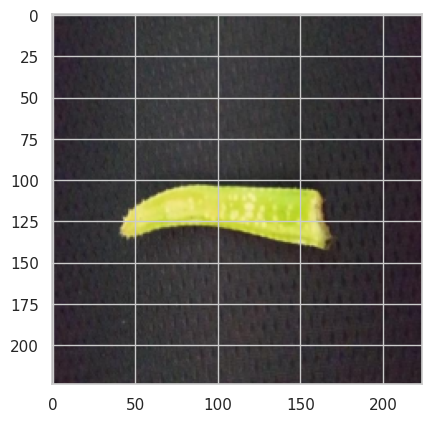

In [54]:
# predicting first image
img, label = test[1]
plt.imshow(img.permute(1, 2, 0))
print('Label:', test_images[1], ', Predicted:', predict_image(img, model))

Label: Rose , Predicted: Aloevera
Label: Eucalyptus , Predicted: Aloevera
Label: Amruthaballi , Predicted: Aloevera


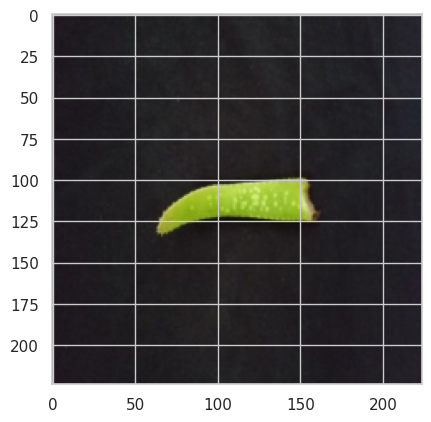

In [68]:
#(actual label vs predicted)
for i in random.sample(range(20),3): # Select 3 random indices
    img, label = test[i]
    plt.imshow(img.permute(1, 2, 0))
    print('Label:', test_images[i], ', Predicted:', predict_image(img, model))

In [66]:
# getting all predictions (actual label vs predicted)
for i in range(18) :
    img, label = test[i]
    print('Label:', test_images[i], ', Predicted:', predict_image(img, model))

Label: Aloevera , Predicted: Aloevera
Label: Amla , Predicted: Aloevera
Label: Amruthaballi , Predicted: Aloevera
Label: Ashoka , Predicted: Aloevera
Label: Ashwagandha , Predicted: Aloevera
Label: Bamboo , Predicted: Aloevera
Label: Eucalyptus , Predicted: Aloevera
Label: Guava , Predicted: Lemon
Label: Jasmine , Predicted: Aloevera
Label: Lemon , Predicted: Aloevera
Label: Mango , Predicted: Aloevera
Label: Mint , Predicted: Aloevera
Label: Neem , Predicted: Aloevera
Label: Papaya , Predicted: Aloevera
Label: Pepper , Predicted: Aloevera
Label: Pipal , Predicted: Aloevera
Label: Rose , Predicted: Aloevera
Label: Tulsi , Predicted: Aloevera
